Copyright (c) 2019 Computational-Medicine

# Kiwi MRI - explore

The 3D dataset, consisting of 128 transaxial slices through the long axis of
the kiwi, was acquired with the 7 T Bruker Pharmascan MRI scanner at the
MIC / Vivarium, University of Bergen, using the 2D RARE pulse sequence
(Echo Train Length = 8, TR = 18520 ms, TE = 63.9 ms, No. of Averages = 2,
Flip Angle = 180 deg, Slice thickness = 0.5 mm, In-plane pixel resolution =
0.234 x 0.234 mm2, Acquisition matrix = 256 x 256, Number of slices = 128).


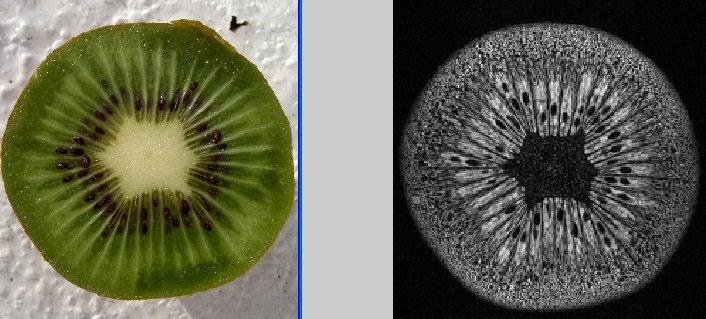

In [13]:
from IPython.display import Image
Image(filename='./assets/kiwi_photo_mri_20050219.jpg', width=600)

**image information can be SPATIAL**

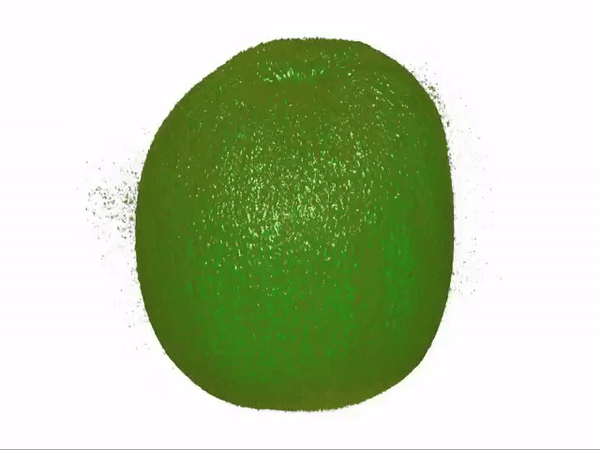

In [14]:
from IPython.display import Image
Image(filename='./assets/kiwi-stian-eikeland-vis-video-to-gif.png', width=600)

**Import libraries**

In [15]:
%matplotlib inline
# This to be able to display figures and graphs within the notebook browser

import os
import pathlib
import glob
import shutil
import warnings
import numpy as np
import pandas as pd
import nibabel as nib
import scipy
import cv2
from nilearn import image
from nilearn import plotting
import matplotlib.pyplot as plt
import seaborn as sns
import imageio
import skimage
import IPython

home = os.path.expanduser('~')  # home is to make path to local home directory
print('home: %s' % home)

home: /home/arvid


In [16]:
mydata = '../data/mri/kiwi'
img_name = '20050217191129_RARE_high_res_axial_131073'
fn = '%s/%s.nii.gz' % (mydata, img_name)

In [17]:
img = nib.load(fn)

In [18]:
print('shape of image = ', img.header.get_data_shape())
print('units = ', img.header.get_xyzt_units())
print('voxel size = ', img.header.get_zooms())
print('dtype = %s' % img.header.get_data_dtype())
data = img.get_data()
print('data shape', data.shape)
print('min = %d' % data.min())
print('max = %d' % data.max())
print('number of slices =', img.shape[-1])

shape of image =  (256, 256, 128)
units =  ('mm', 'sec')
voxel size =  (0.234375, 0.234375, 0.5)
dtype = int16
data shape (256, 256, 128)
min = 71
max = 32766
number of slices = 128


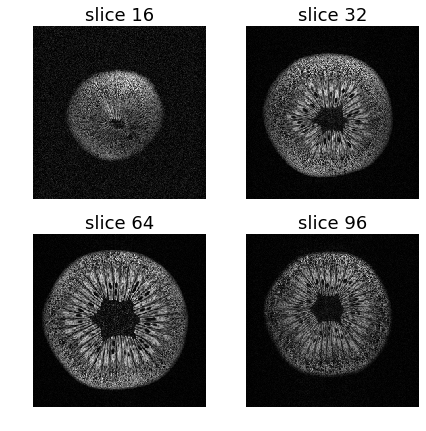

In [19]:
s = [16, 32, 64, 96]
fig = plt.figure('Showing the kiwi image', figsize = [7, 7])
plt.tight_layout
plt.subplot(2, 2, 1).set_axis_off(), plt.title('slice %d' % s[0], fontsize=18)
plt.imshow(data[:, :, s[0]].T, cmap='gray', origin='lower')  # .T for transpose to correct orientation
plt.subplot(2, 2, 2).set_axis_off(), plt.title('slice %d' % s[1], fontsize=18)
plt.imshow(data[:, :, s[1]].T, cmap='gray', origin='lower')
plt.subplot(2, 2, 3).set_axis_off(), plt.title('slice %d' % s[2], fontsize=18)
plt.imshow(data[:, :, s[2]].T, cmap='gray', origin='lower')
plt.subplot(2, 2, 4).set_axis_off(), plt.title('slice %d' % s[3], fontsize=18)
plt.imshow(data[:, :, s[3]].T, cmap='gray', origin='lower')
plt.show()

#fig.savefig('%s/prj/BMED360/results/flash_dess_fisp_psif_channel_images.png' % (home),
#            transparent=False, dpi=300, bbox_inches="tight")

> **CHECK:** 
>
> - *Coordiante systems and affine transforms in medical imaging (e.g. [nibabel](http://nipy.org/nibabel/coordinate_systems.html) / [nilearn](http://nilearn.github.io/auto_examples/04_manipulating_images/plot_affine_transformation.html))*
> - *Converting from DICOM-format (privided by the scanner) to NIFTI-format for processing (e.g. [dcm2nii](https://www.nitrc.org/plugins/mwiki/index.php/dcm2nii:MainPage) og [dcm2niix](https://github.com/rordenlab/dcm2niix))*

In [20]:
aff = img.affine
print('affine header:\n', aff)

affine header:
 [[ -0.234375   0.        -0.        27.      ]
 [ -0.         0.234375  -0.       -26.265625]
 [  0.         0.         0.5      -30.75    ]
 [  0.         0.         0.         1.      ]]
